<a href="https://colab.research.google.com/github/Garvit-Pahwa-03/Generative-Adversarial-Network/blob/main/Logodetection2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
%pip install -q ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 974.5/974.5 kB 14.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 61.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 32.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 39.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 9.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 52.4 MB/s eta 0:00:00


In [ ]:
!git clone https://github.com/ultralytics/ultralytics.git
%cd ultralytics
%pip install -qr requirements.txt

Cloning into 'ultralytics'...
remote: Enumerating objects: 55989, done.
remote: Counting objects: 100% (41/41), done.
remote: Compressing objects: 100% (28/28), done.
remote: Total 55989 (delta 24), reused 13 (delta 13), pack-reused 55948 (from 2)
Receiving objects: 100% (55989/55989), 30.89 MiB | 21.03 MiB/s, done.
Resolving deltas: 100% (41559/41559), done.
/content/ultralytics
ERROR: Could not open requirements file: [Errno 2] No such file or directory: 'requirements.txt'


In [ ]:
import torch

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"Using torch {torch.__version__} on {torch.cuda.get_device_properties(0).name if torch.cuda.is_available() else 'CPU'}")

Using torch 2.6.0+cu124 on CPU


In [ ]:
import zipfile
import os

# Define target folders
dataset_path = "/content/dataset"

# Unzip train images
with zipfile.ZipFile("/content/images.zip", 'r') as zip_ref:
    zip_ref.extractall(dataset_path)
    print("✅ Extracted train images to:", dataset_path)

# Unzip label files
with zipfile.ZipFile("/content/labels.zip", 'r') as zip_ref:
    zip_ref.extractall(dataset_path)
    print("✅ Extracted labels to:", dataset_path)


✅ Extracted train images to: /content/dataset
✅ Extracted labels to: /content/dataset


In [ ]:
import os
import random
import shutil
from pathlib import Path

# Paths to source data
source_images = Path("/content/dataset/images")
source_labels = Path("/content/dataset/labels")

# Paths to new split folders
split_base = Path("/content/dataset_split")
train_img_dir = split_base / "train" / "images"
train_lbl_dir = split_base / "train" / "labels"
test_img_dir = split_base / "test" / "images"
test_lbl_dir = split_base / "test" / "labels"

# Create the split folder structure
for folder in [train_img_dir, train_lbl_dir, test_img_dir, test_lbl_dir]:
    folder.mkdir(parents=True, exist_ok=True)

# Get list of all image files
image_files = list(source_images.glob("*.jpg"))
random.shuffle(image_files)

# Train/Test split
split_ratio = 0.8
split_index = int(len(image_files) * split_ratio)
train_files = image_files[:split_index]
test_files = image_files[split_index:]

# Move images + corresponding labels
def copy_files(file_list, img_dest, lbl_dest):
    for img_path in file_list:
        label_path = source_labels / f"{img_path.stem}.txt"
        if label_path.exists():
            shutil.copy(img_path, img_dest / img_path.name)
            shutil.copy(label_path, lbl_dest / label_path.name)

copy_files(train_files, train_img_dir, train_lbl_dir)
copy_files(test_files, test_img_dir, test_lbl_dir)

print(f"✅ Split complete: {len(train_files)} train images, {len(test_files)} test images.")


✅ Split complete: 400 train images, 100 test images.


In [ ]:
# Create proper data.yaml file
yaml_content = """\
train: /content/dataset_split/train
val: /content/dataset_split/train

nc: 1
names: ['logo']
"""

# Save it
with open("/content/data.yaml", "w") as f:
    f.write(yaml_content)

print("✅ Final data.yaml created!")
!cat /content/data.yaml

✅ Final data.yaml created!
train: /content/dataset_split/train
val: /content/dataset_split/train

nc: 1
names: ['logo']


In [ ]:
!yolo task=detect mode=train model=yolov8s.pt data=/content/data.yaml epochs=150 imgsz=640 batch=16

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.
100% 21.5M/21.5M [00:00<00:00, 106MB/s] 
Ultralytics 8.3.107 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolov8s.pt, data=/content/data.yaml, epochs=150, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, conf=None, i

In [ ]:
!yolo task=detect mode=predict model=/content/ultralytics/runs/detect/train/weights/best.pt source=/content/dataset_split/test/images imgsz=640 conf=0.1 save=True

Ultralytics 8.3.107 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 11,125,971 parameters, 0 gradients, 28.4 GFLOPs

image 1/100 /content/dataset_split/test/images/013e0cca-47f5-4514-bcdd-7f6d9738b97e.jpg: 480x640 1 logo, 39.9ms
image 2/100 /content/dataset_split/test/images/067bb1a5-3722-44c1-aa74-c4560819ed6c.jpg: 480x640 1 logo, 13.1ms
image 3/100 /content/dataset_split/test/images/06ec3a3a-d19a-46cc-b62a-1dedac919cf3.jpg: 480x640 3 logos, 13.1ms
image 4/100 /content/dataset_split/test/images/0770a5d1-8419-4512-95c2-4d9d751d5758.jpg: 640x480 1 logo, 37.2ms
image 5/100 /content/dataset_split/test/images/088d32ba-8839-4333-a2a0-356baa97b640.jpg: 640x480 1 logo, 12.0ms
image 6/100 /content/dataset_split/test/images/0c9e1d96-b96d-4fd0-b9eb-1b764de3540f.jpg: 640x480 1 logo, 12.0ms
image 7/100 /content/dataset_split/test/images/0e894e80-e55b-4b35-b468-6b291ac6469d.jpg: 640x480 1 logo, 12.0ms
image 8/100 /content/dataset_split/test/images/0e

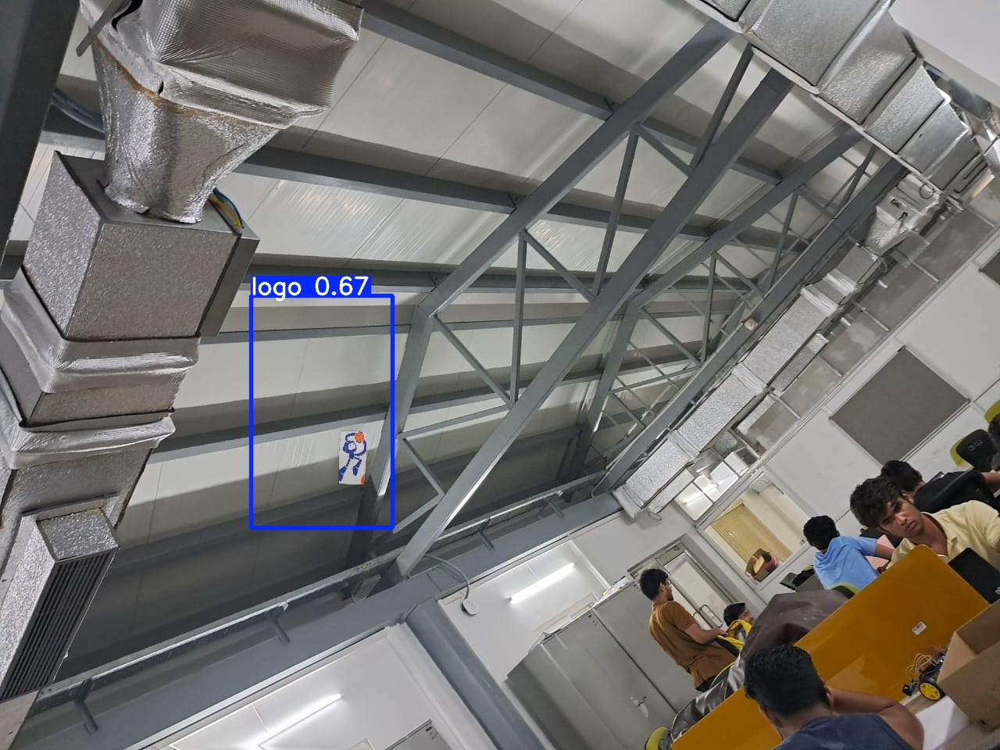

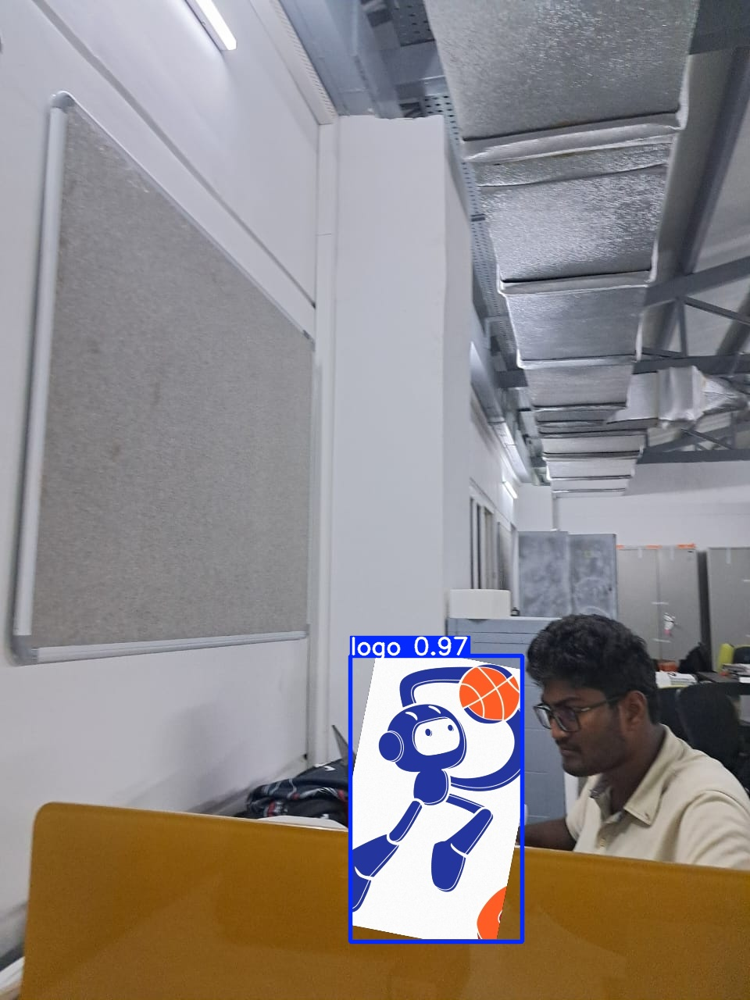

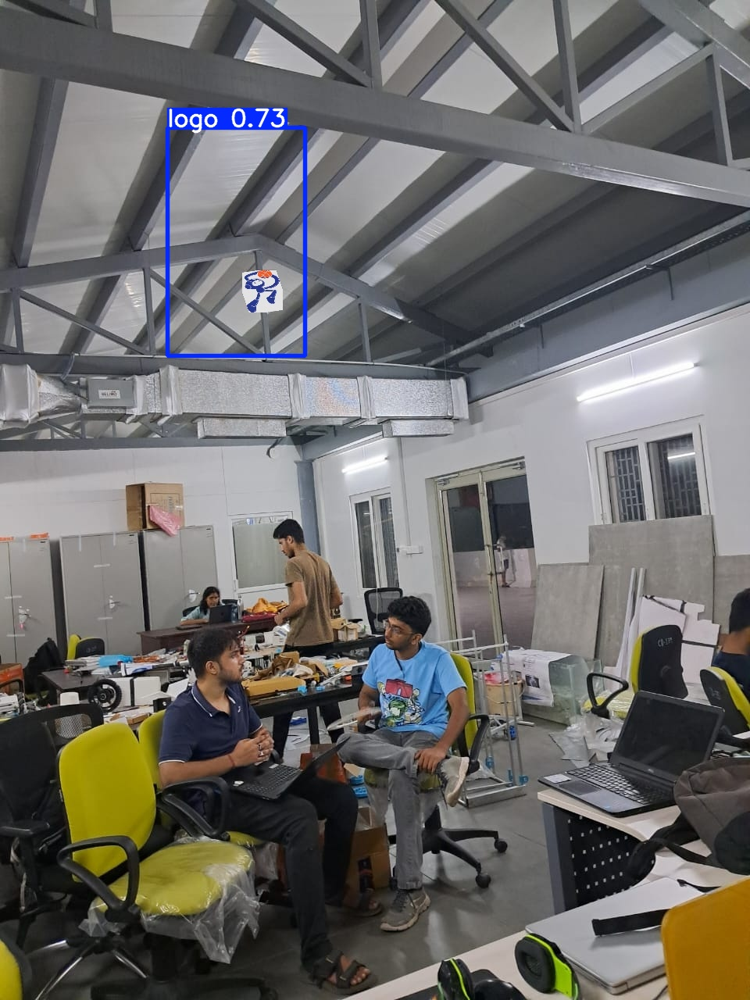

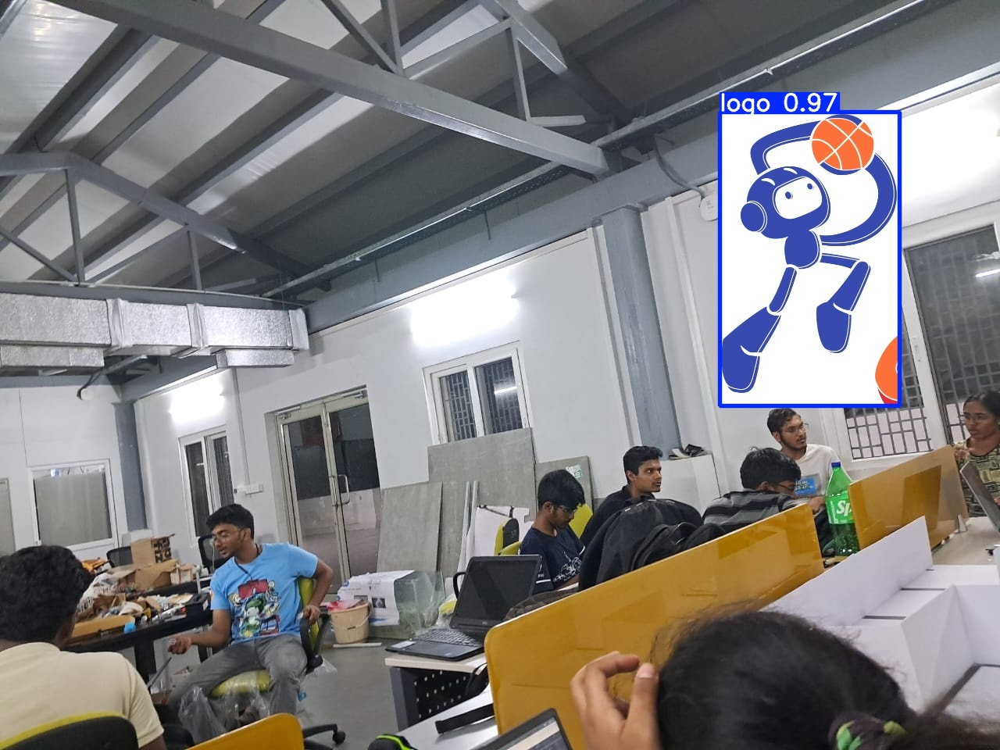

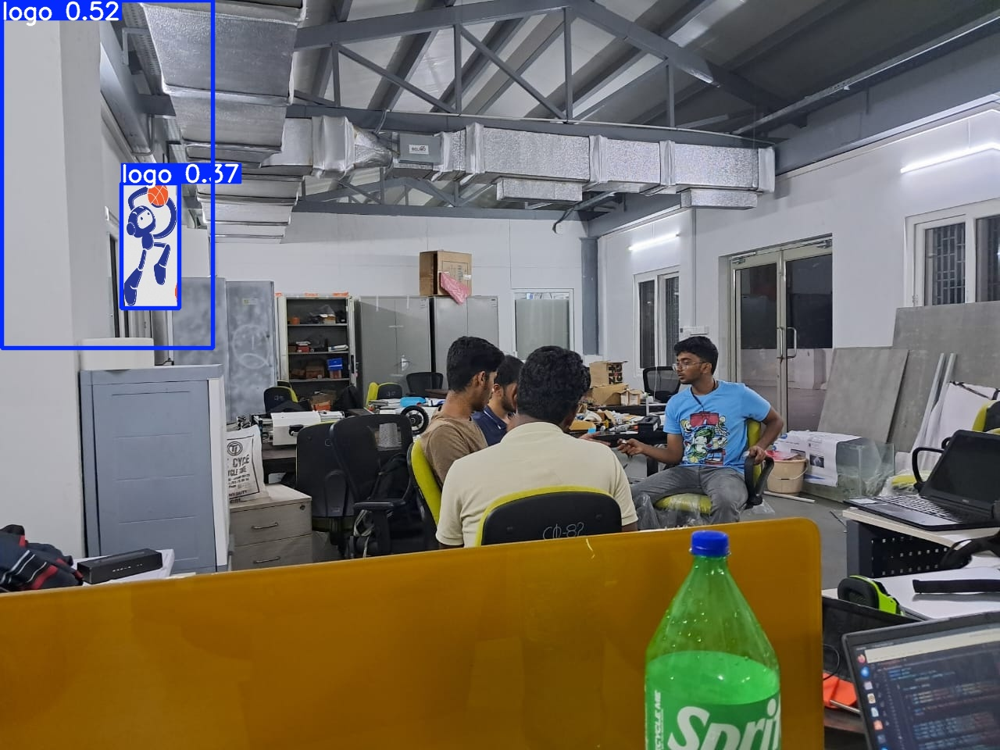

...

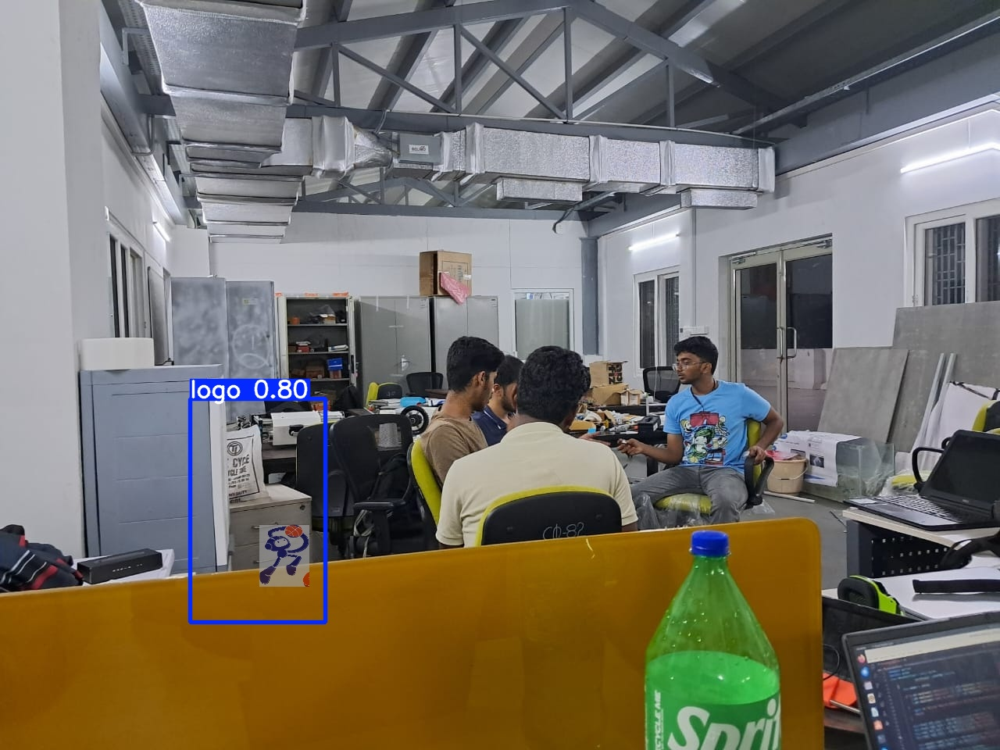

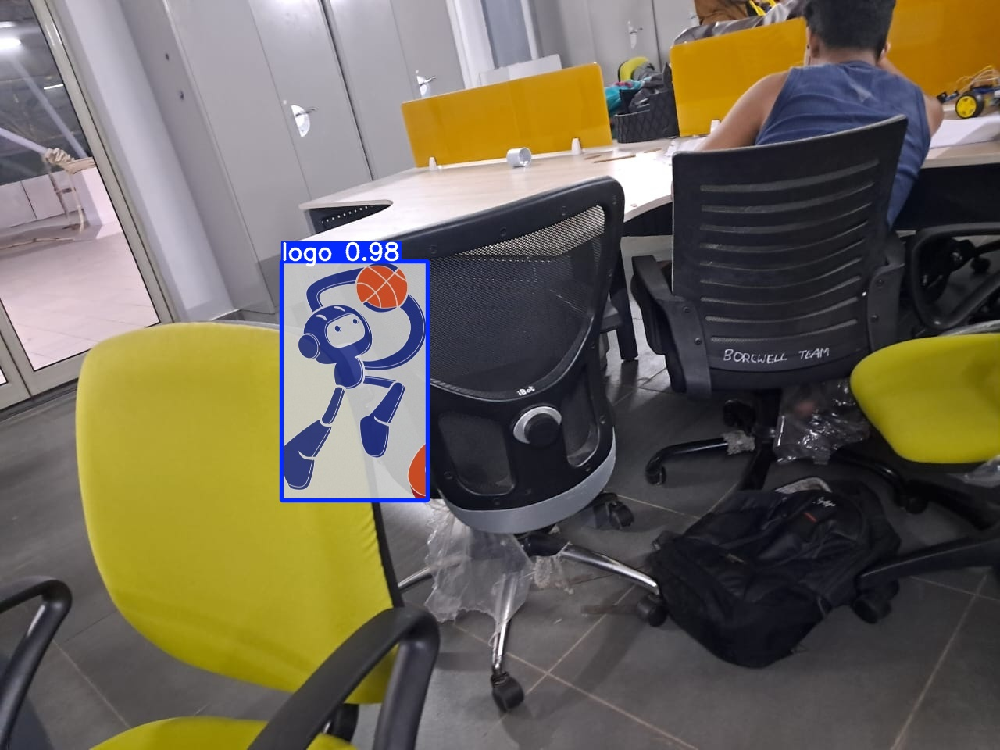

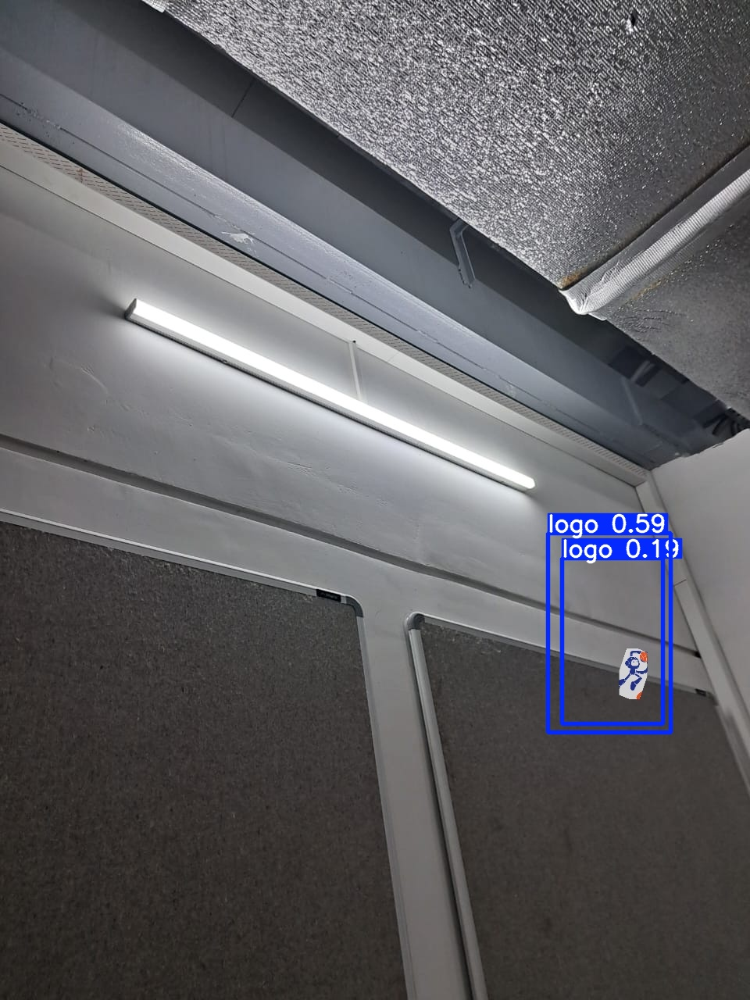

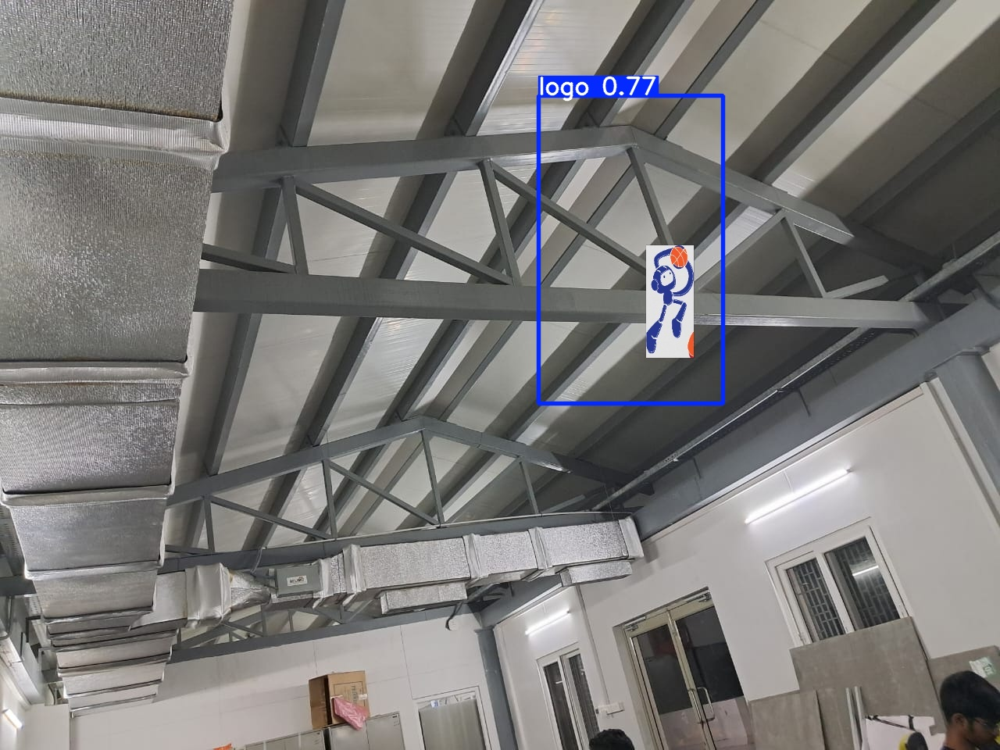

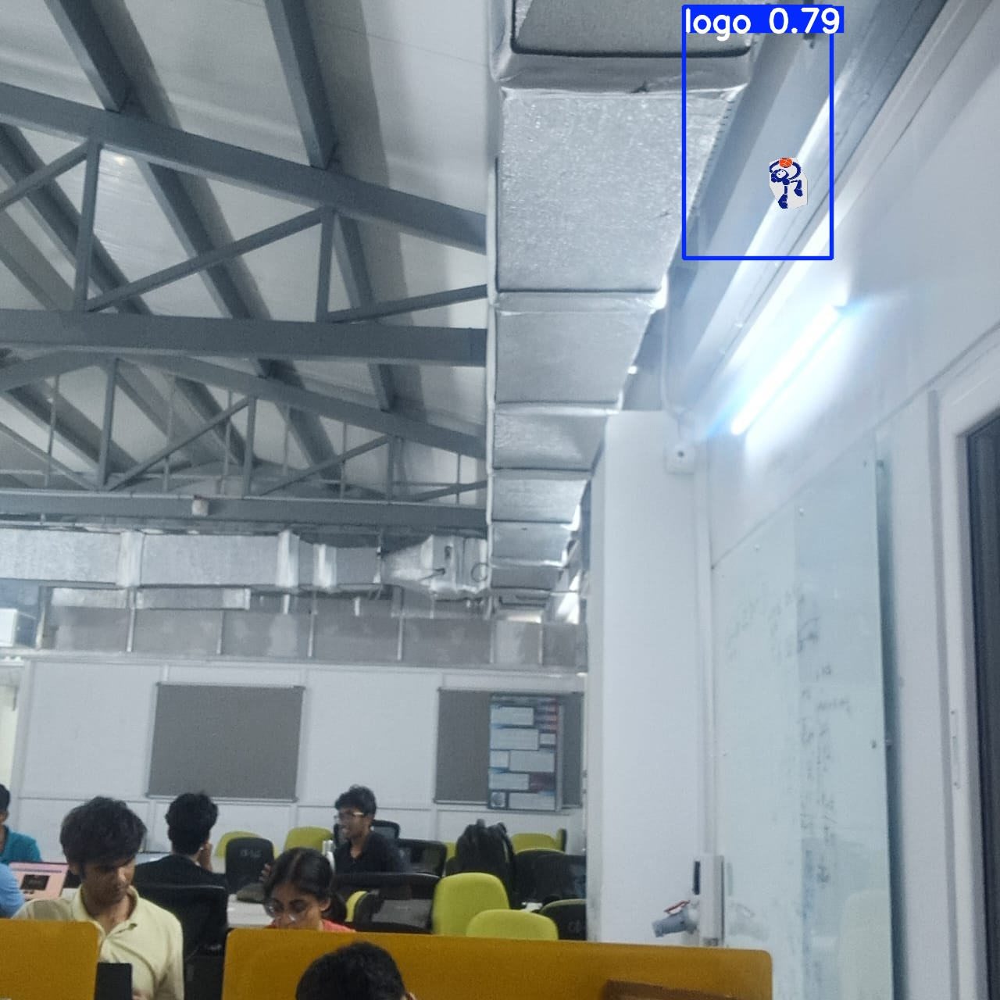

In [ ]:
import glob
from IPython.display import Image, display

for img_path in glob.glob('runs/detect/predict/*.jpg'):
    display(Image(filename=img_path))
    print("\n")

In [ ]:
!zip -r /content/ultralytics.zip /content/ultralytics

  adding: content/ultralytics/ (stored 0%)
  adding: content/ultralytics/examples/ (stored 0%)
  adding: content/ultralytics/examples/YOLOv8-ONNXRuntime-CPP/ (stored 0%)
  adding: content/ultralytics/examples/YOLOv8-ONNXRuntime-CPP/README.md (deflated 61%)
  adding: content/ultralytics/examples/YOLOv8-ONNXRuntime-CPP/main.cpp (deflated 70%)
  adding: content/ultralytics/examples/YOLOv8-ONNXRuntime-CPP/inference.cpp (deflated 74%)
  adding: content/ultralytics/examples/YOLOv8-ONNXRuntime-CPP/CMakeLists.txt (deflated 70%)
  adding: content/ultralytics/examples/YOLOv8-ONNXRuntime-CPP/inference.h (deflated 58%)
  adding: content/ultralytics/examples/YOLOv8-Region-Counter/ (stored 0%)
  adding: content/ultralytics/examples/YOLOv8-Region-Counter/README.md (deflated 62%)
  adding: content/ultralytics/examples/YOLOv8-Region-Counter/yolov8_region_counter.py (deflated 67%)
  adding: content/ultralytics/examples/object_counting.ipynb (deflated 65%)
  adding: content/ultralytics/examples/YOLOv8-MN